# Example GEOtop Calibration Report

What follows is an example of GEOtop calibration report.

In [1]:
# Defaults
model_path = '../data/testbed/inputs'
timeout = 120
observations_path = '../data/testbed/observations/obs.csv'
parameters_path = '../data/parameters/testbed.csv'
default_parameters = {}
algorithm = 'Random'
popsize = 2
num_generations = 2
scheduler_file = None
num_cpus = 2
num_workers = 2
performance_report_filename='report.html'

In [2]:
# Parameters
model_path = "/scratch/scampane/MHPC-project/data/DOMES/inputs"
timeout = 150
observations_path = "/scratch/scampane/MHPC-project/data/DOMES/observations/obs.csv"
parameters_path = "/scratch/scampane/MHPC-project/data/parameters/all.csv"
algorithm = "NGO"
popsize = 128
num_generations = 32
scheduler_file = "/scratch/scampane/MHPC-project/scheduler_files/scheduler-Q61.json"
num_cpus = 256
num_workers = 32
performance_report_filename = "/scratch/scampane/MHPC-project/runs/short/DOMES-NGO-4096-256-DeW-performance-report.html"


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scrapbook as sb
import dask.config
from dask.distributed import Client, performance_report

from mhpc_project.utils import date_parser, kge_cmp, calibrate, delta_mim
from mhpc_project.parameters import UniformSoilParameters as Parameters
from mhpc_project.models import UniformSoilModel as Model
import mhpc_project.plots as plots

In [4]:
# Store dask config
sb.glue('dask_config', dask.config.config)

In [5]:
parameters = Parameters(parameters_path, default_parameters)
model = Model(model_path, store=False, timeout=timeout)
observations = pd.read_csv(observations_path,
                           parse_dates=[0],
                           date_parser=date_parser,
                           index_col=0)


In [6]:
if scheduler_file:
    client = Client(scheduler_file=scheduler_file)
else:
    client = Client()
client.wait_for_workers(n_workers=num_workers, timeout=240)

In [7]:
with performance_report(filename=performance_report_filename):
    recommendation, predictions, log = calibrate(model,
                                                 parameters,
                                                 observations,
                                                 algorithm,
                                                 popsize,
                                                 num_generations,
                                                 client,
                                                 num_cpus)

sb.glue('loss', kge_cmp(predictions, observations))
sb.glue('log', [((x.generation, x.args[0]), l, t) for (x, l, t) in log])

(64_w,128)-aCMA-ES (mu_w=34.2,w_1=6%) in dimension 29 (seed=nan, Thu Feb 18 09:36:33 2021)


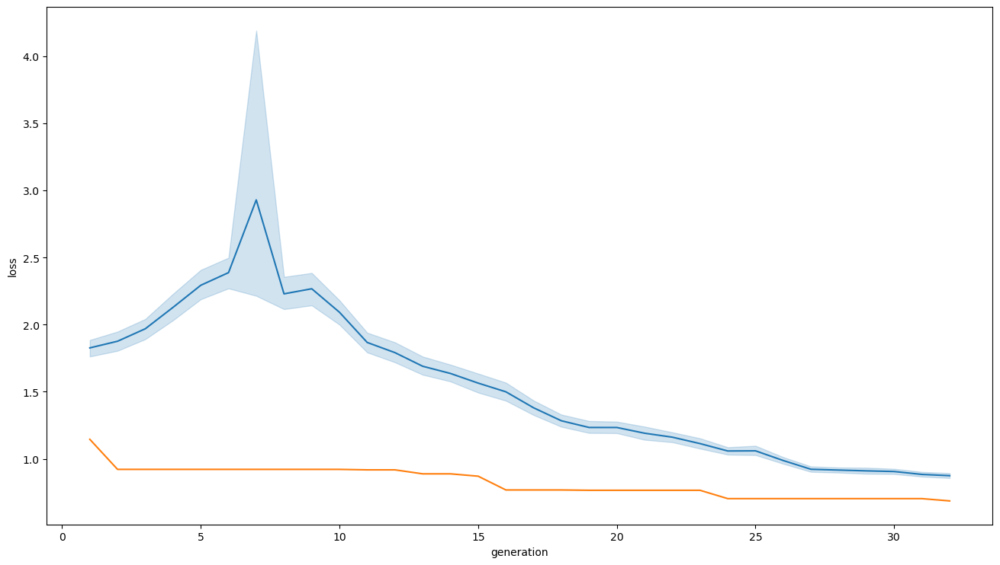

In [8]:
plot = plots.convergence([(x.generation, l) for x, l, _ in log if np.isfinite(l)])
plt.close(plot)
sb.glue('convergence_plot', plot, 'display')

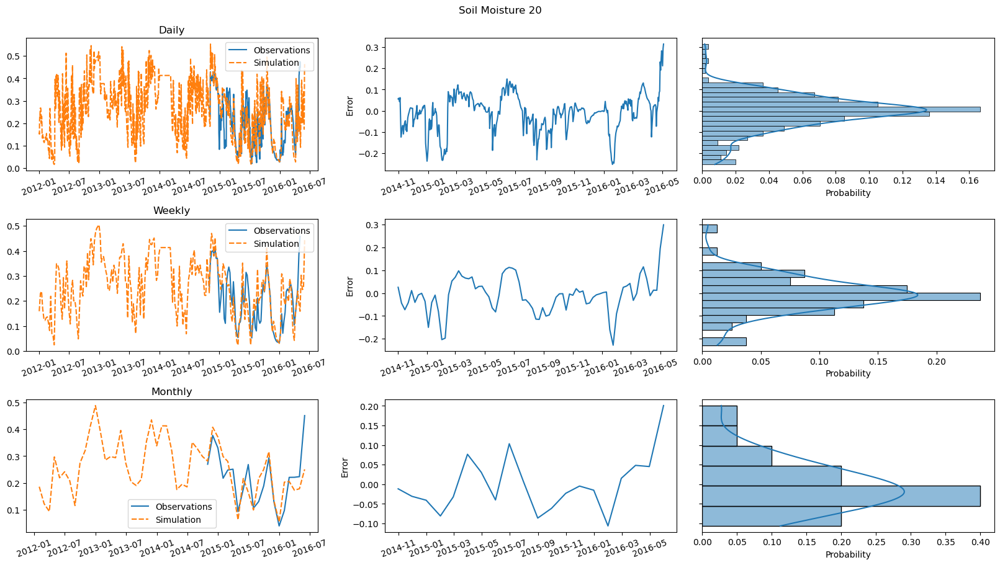

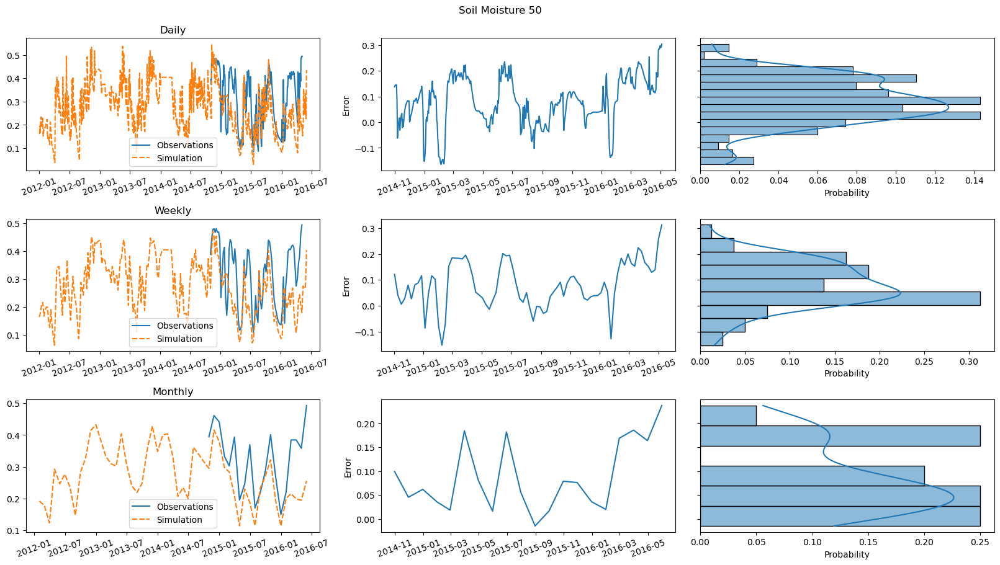

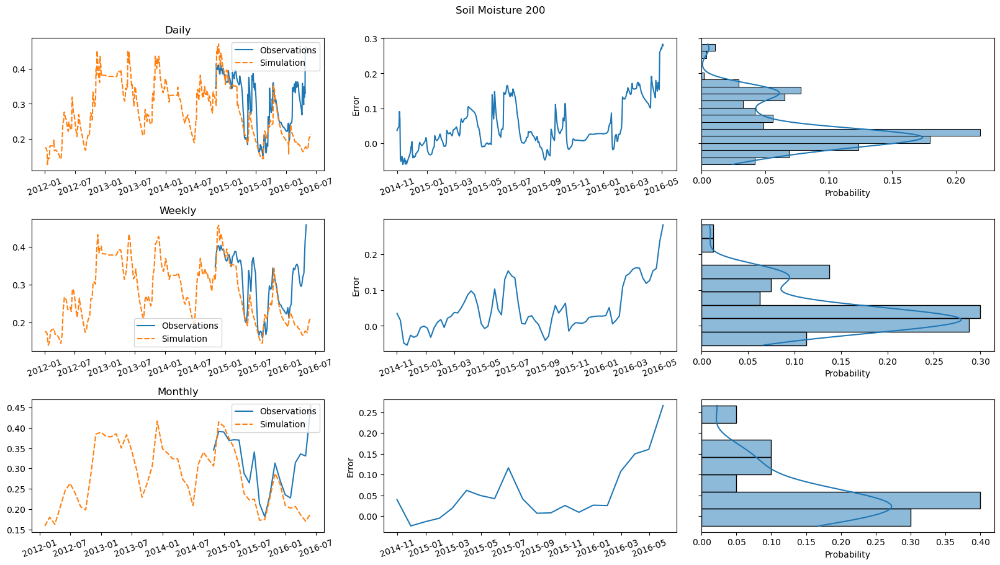

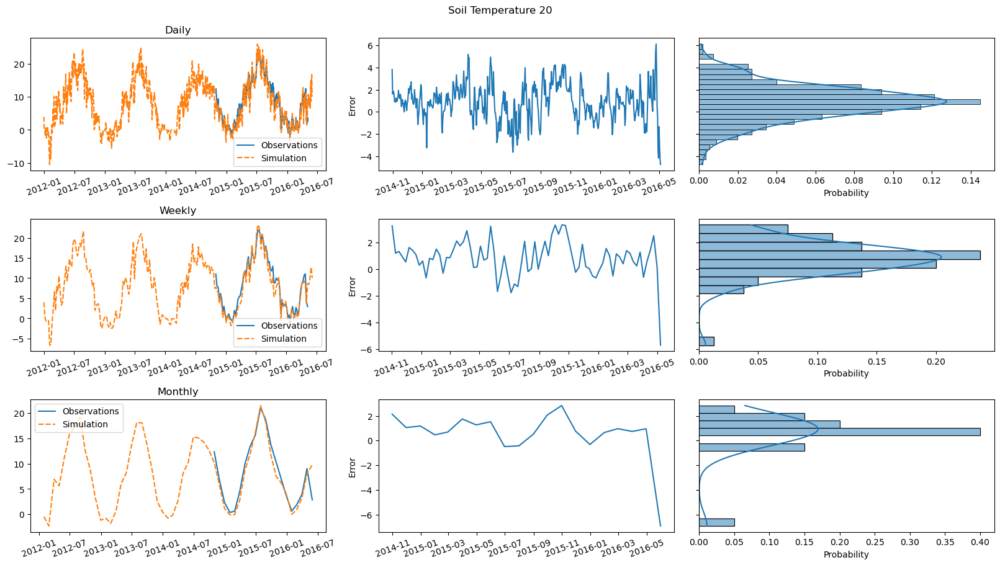

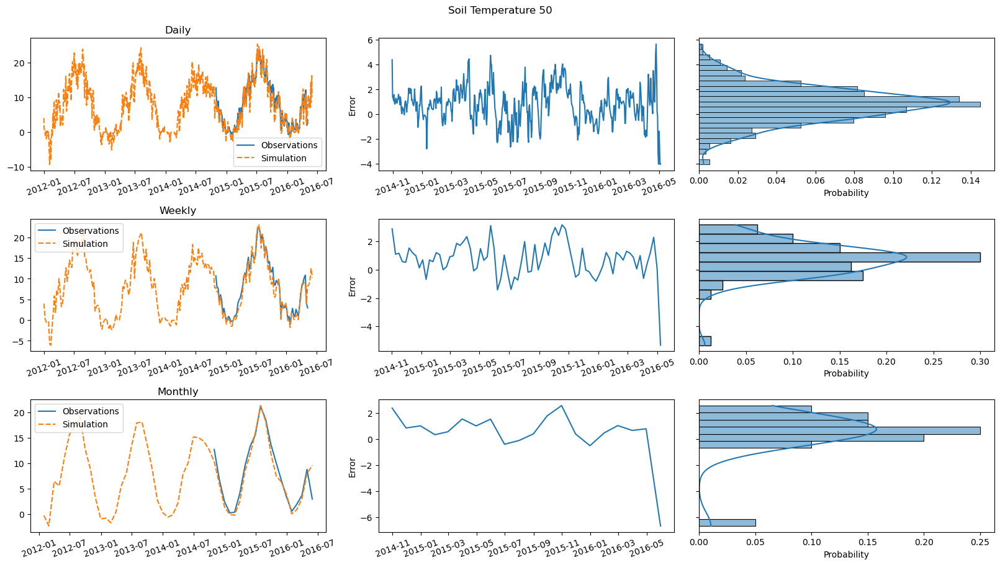

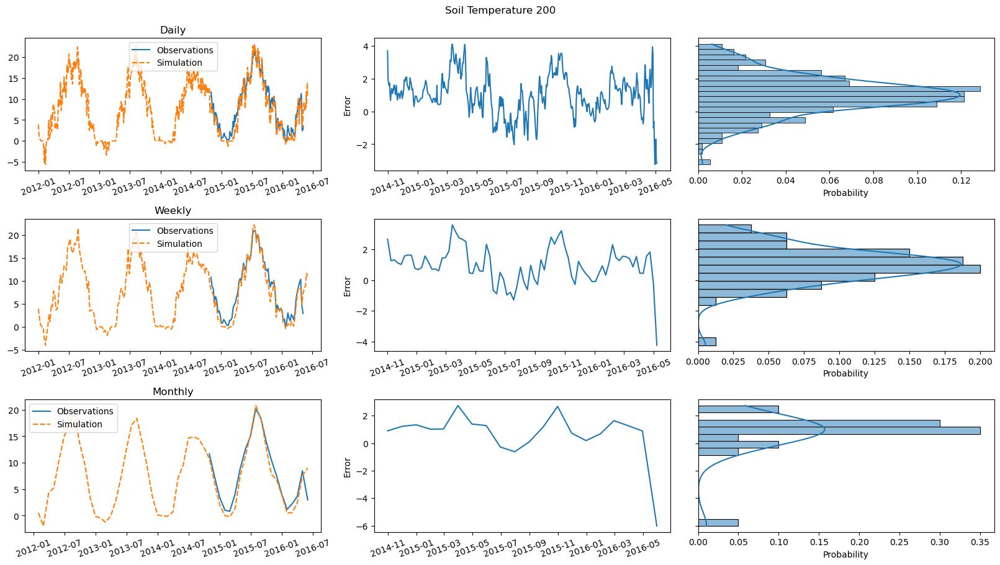

In [9]:
for name, plot in plots.comparisons(predictions, observations).items():
    plt.close(plot)
    sb.glue(name + '_plot', plot, 'display')

In [10]:
report = delta_mim(parameters, [(x.args[0], l) for x, l, t in log if np.isfinite(l)])
report['best'] = parameters.from_instrumentation(recommendation)
sb.glue('report', report, 'pandas')

report.sort_values('delta', key=np.abs, ascending=False)

,delta,delta_conf,S1,S1_conf,best
FieldCapacity,0.196860,0.016790,0.083046,0.231401,3.870706e-02
ThetaRes,0.180005,0.014483,0.104353,0.282825,2.985520e-03
ThetaSat,0.168758,0.015870,0.097108,0.266497,5.557729e-01
DecayCoeffCanopy,0.167036,0.012630,0.087294,0.237451,1.165855e+00
NormalHydrConductivity,0.163122,0.018452,0.043401,0.147470,1.975318e-04
CanopyFraction,0.162160,0.017316,0.054883,0.169293,8.927573e-01
MinStomatalRes,0.152129,0.013413,0.043169,0.110797,2.081448e+02
AlphaVanGenuchten,0.137440,0.014014,0.056531,0.136567,2.450772e-03
NVanGenuchten,0.136678,0.017649,0.039043,0.125220,1.827232e+00
LSAI,0.127544,0.017510,0.039181,0.119751,2.178355e+00
